In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14733, done.
remote: Counting objects: 100% (303/303), done.
remote: Compressing objects: 100% (143/143), done.
remote: Total 14733 (delta 202), reused 242 (delta 160), pack-reused 14430
Receiving objects: 100% (14733/14733), 13.48 MiB | 19.42 MiB/s, done.
Resolving deltas: 100% (10180/10180), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 13.8 MB/s 
     |████████████████████████████████| 41 kB 194 kB/s 
     |████████████████████████████████| 67 kB 4.5 MB/s 
     |████████████████████████████████| 54 kB 3.2 MB/s 
     |████████████████████████████████| 145 kB 31.9 MB/s 
     |████████████████████████████████| 178 kB 34.8 MB/s 
     |████████████████████████████████| 138 kB 37.7 MB/s 
     |████████████████████████████████| 62 kB 1.3 MB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="YGCqXD8iWRgxbU21A5lY")
project = rf.workspace("research-3ugl7").project("markerpens")
dataset = project.version(7).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/markerpens-7 in yolov5pytorch:: 100%|██████████| 232/232 [00:01<00:00, 163.30it/s]


In [ ]:
!python train.py --img 416 --batch 16 --epochs 1000 --patience 0 --data {dataset.location}/data.yaml --weights yolov5x.pt --cache

Streaming output truncated to the last 5000 lines.

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      3/999      6.71G     0.0962     0.0389    0.03511         59        416: 100% 6/6 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:00<00:00,  3.92it/s]
                   all         17         68      0.865      0.214      0.136     0.0686

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      4/999      6.71G     0.0937    0.03576    0.03045         52        416: 100% 6/6 [00:02<00:00,  2.06it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:00<00:00,  4.13it/s]
                   all         17         68      0.902      0.235      0.155     0.0469

      Epoch    GPU_mem   box_loss   obj_loss   cls_loss  Instances       Size
      5/999      6.71G    0.09192    0.03655    0.02705     

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 210), started 1:51:51 ago. (Use '!kill 210' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.5 --source {dataset.location}/test/images

detect: weights=['runs/train/exp2/weights/best.pt'], source=/content/datasets/markerpens-7/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-217-ga625f29 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 322 layers, 86193601 parameters, 0 gradients, 203.8 GFLOPs
image 1/5 /content/datasets/markerpens-7/test/images/pens--76-_jpg.rf.0c1936ddc4d87fc2225cae47f1ce8f7a.jpg: 416x320 1 B, 1 C, 1 R, 1 ROI, 55.6ms
image 2/5 /content/datasets/markerpens-7/test/images/pens--77-_jpg.rf.7991398c6e285c1bdbdf2c3903e7d54a.jpg: 416x320 1 B, 1 C, 1 R, 1 ROI, 54.2ms
image 3/5 /content/datasets/mar

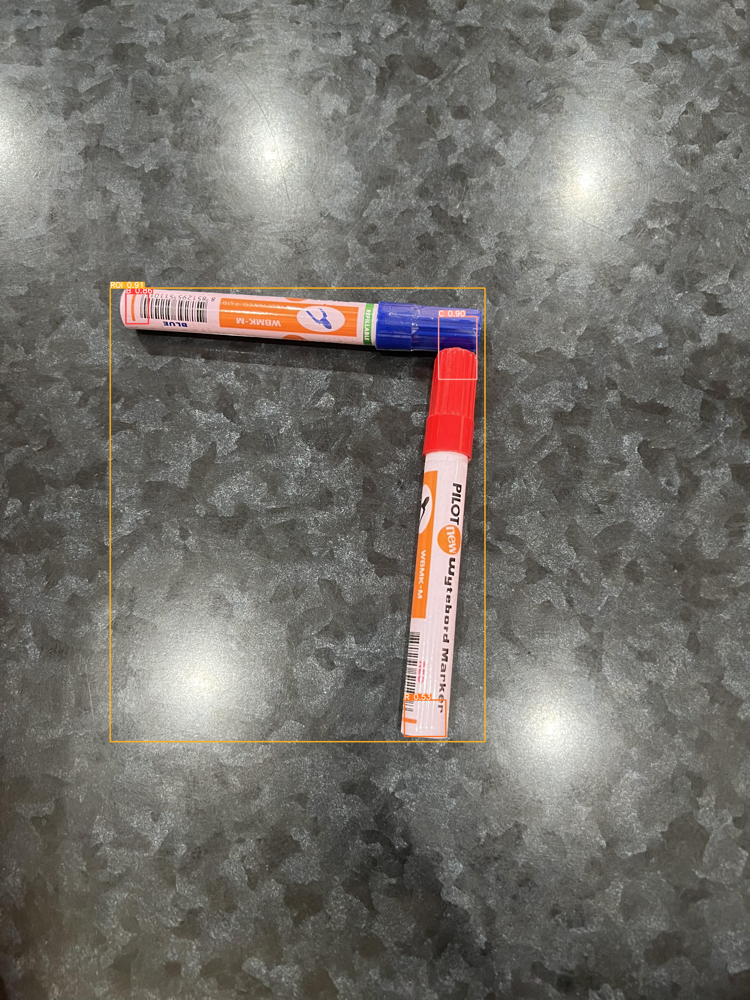

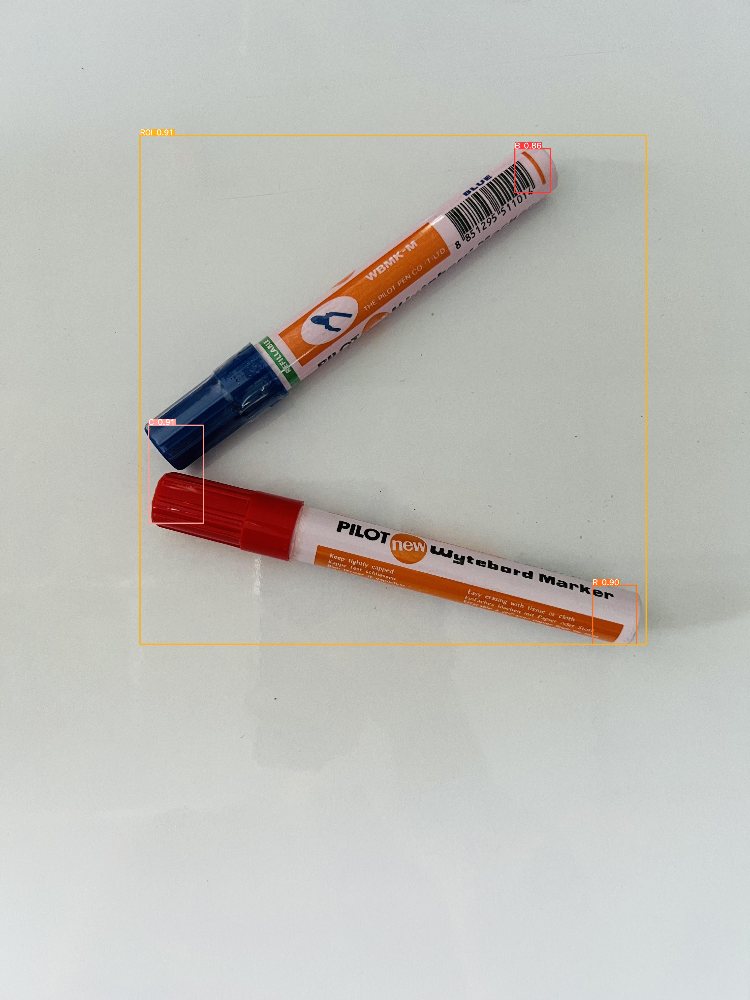

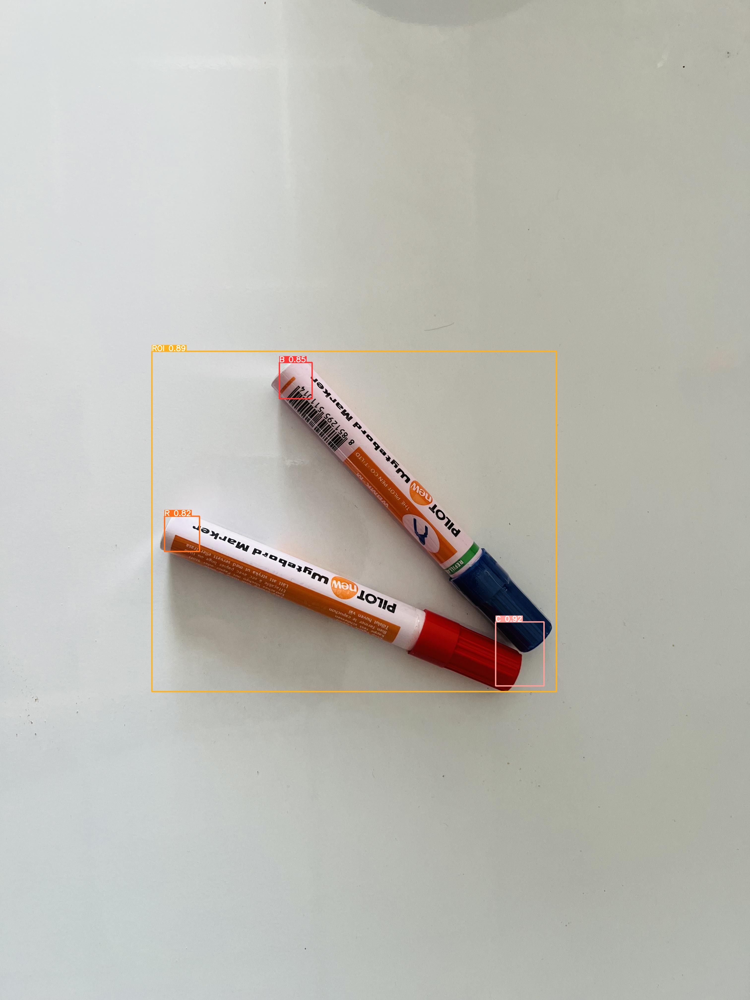

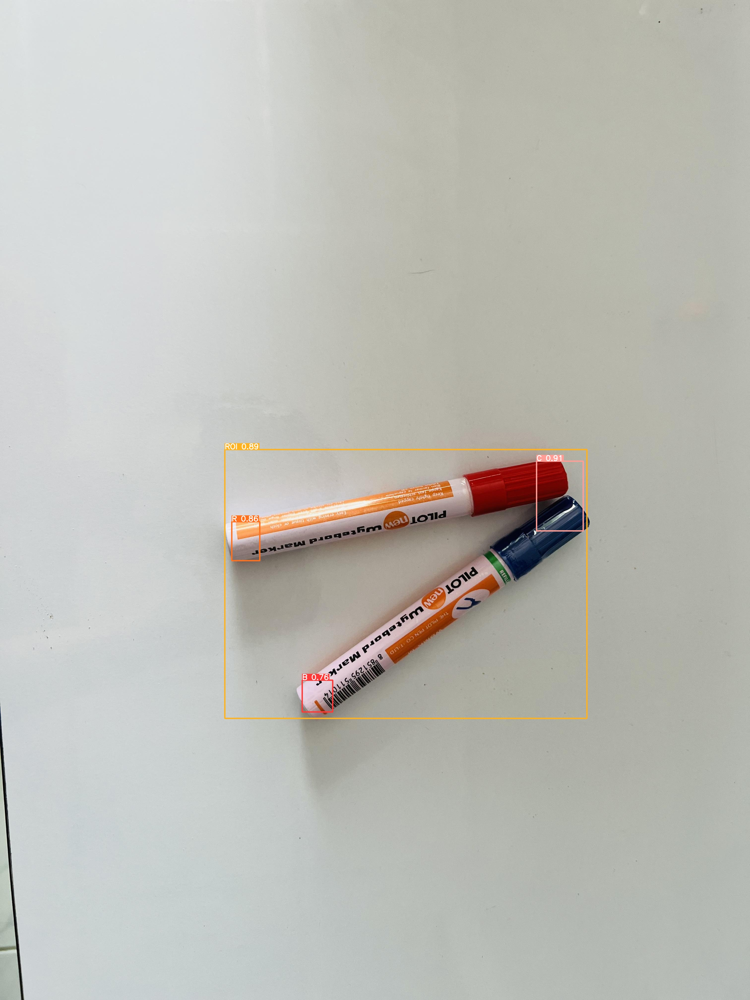

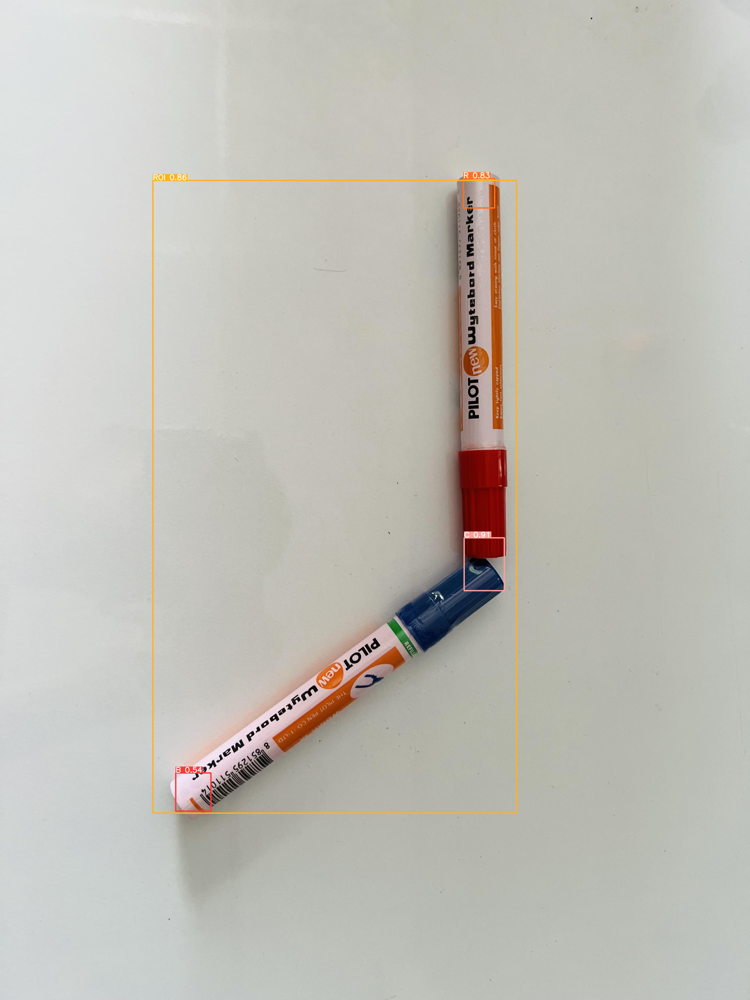

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('./runs/train/exp2/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
%cp /content/yolov5/runs/train/exp2/weights/best.pt /content/gdrive/My\ Drive

Mounted at /content/gdrive


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
%cp /content/yolov5 /content/gdrive/My\ Drive/yolov5 -r

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [2]:
%cd ..
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive
%cd /mydrive/yolov5
!ls

/content
Mounted at /content/gdrive
/content/gdrive/My Drive/yolov5
benchmarks.py	 export.py    README.md		test		yolov5.ipynb
classify	 hubconf.py   requirements.txt	train.py	yolov5x.pt
CONTRIBUTING.md  LICENSE      runs		tutorial.ipynb
data		 models       segment		utils
detect.py	 __pycache__  setup.cfg		val.py


In [3]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 416 --conf 0.5 --source test/images

detect: weights=['runs/train/exp2/weights/best.pt'], source=test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-217-ga625f29 Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 322 layers, 86193601 parameters, 0 gradients, 203.8 GFLOPs
image 1/2 /content/gdrive/MyDrive/yolov5/test/images/test1.jpg: 416x320 1 B, 1 C, 1 R, 1 ROI, 54.5ms
image 2/2 /content/gdrive/MyDrive/yolov5/test/images/test2.jpg: 416x320 1 B, 1 C, 1 R, 1 ROI, 54.1ms
Speed: 0.4ms pre-process, 54.3ms inference, 21.7ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp3


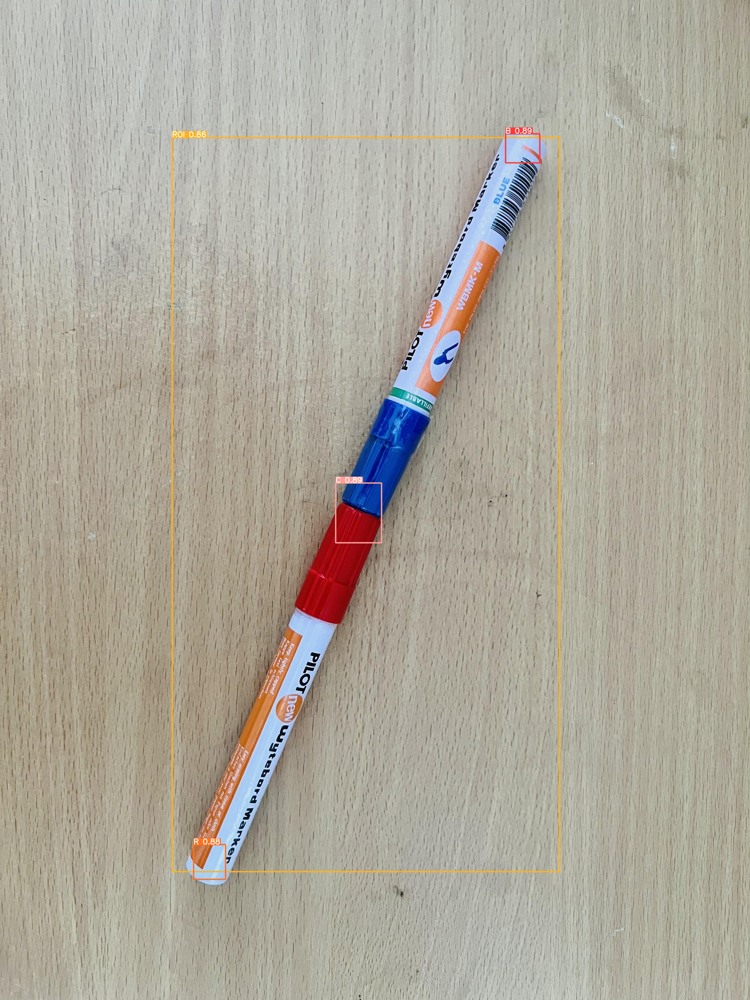

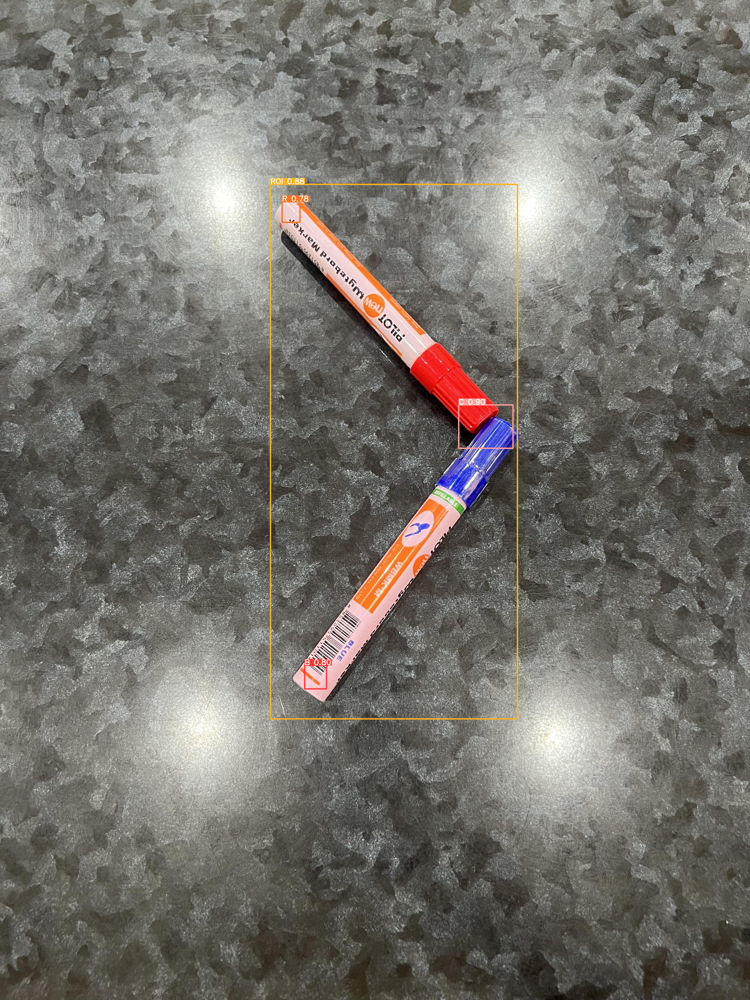

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")